# Importar librerias

In [93]:
import os
import pandas as pd
from pandas import Series, DataFrame
import numpy as np
import matplotlib.pyplot as plt  # Importing pyplot from matplotlib instead of 'pylab'
import matplotlib.ticker as mtick
import seaborn as sns
from IPython.display import HTML, display


# Models
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import roc_curve, auc, classification_report, confusion_matrix
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, f1_score, log_loss
from sklearn.svm import LinearSVC
import xgboost as xgb
import lightgbm as lgb
from sklearn.neural_network import MLPClassifier


# Models:
from sklearn import svm
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LinearRegression

# Python utilities:
import time
import os

print('Se han importado las librerías exitosamente !')

Se han importado las librerías exitosamente !


# Importar bases de datos

In [94]:
df_training = pd.read_csv('C:\\Users\\Bi_analyst\\Desktop\\Python\\TFM\\training_original.csv', sep=",")
df_test = pd.read_csv('C:\\Users\\Bi_analyst\\Desktop\\Python\\TFM\\test_original.csv', sep=",")

training = df_training.copy()
test = df_test.copy()

print('Se ha cargado la BD exitosamente, sos un crack !')


Se ha cargado la BD exitosamente, sos un crack !


# Exploratory Data Analysis - EDA

In [95]:
# Visualizamos training
print('\n' , '*** Muestra training ***' , '\n' , training.head(10).to_string(index=False, header=True))
print('\n' , '*** Freq. valores NA training ***' , '\n' , training.isnull().sum())

# Visualizamos test

print('\n' , '*** Muestra test ***' , '\n' , test.head(10).to_string(index=False, header=True))
print('\n' , '*** Freq. valores NA test ***' , '\n' , test.isnull().sum())


 *** Muestra training *** 
  Unnamed: 0  SeriousDlqin2yrs  RevolvingUtilizationOfUnsecuredLines  age  NumberOfTime30-59DaysPastDueNotWorse   DebtRatio  MonthlyIncome  NumberOfOpenCreditLinesAndLoans  NumberOfTimes90DaysLate  NumberRealEstateLoansOrLines  NumberOfTime60-89DaysPastDueNotWorse  NumberOfDependents
          1                 1                              0.766127   45                                     2    0.802982         9120.0                               13                        0                             6                                     0                 2.0
          2                 0                              0.957151   40                                     0    0.121876         2600.0                                4                        0                             0                                     0                 1.0
          3                 0                              0.658180   38                                     1    0.085

Presencia de valores NA en variables SeriousDlqin2yrs, MonthlyIncome y NumberOfDependents

In [96]:
# Se modifica el nombre de la columna Unnamed con el nombre ID
training.rename(columns={'Unnamed: 0':'ID'}, inplace=True)
test.rename(columns={'Unnamed: 0':'ID'}, inplace=True)

In [ ]:
# Visualizamos descripción de training
description_training = training.drop(columns=['ID']).describe().round(decimals=3)
print(description_training.to_string())

# Visualizamos descripción de test
description_test = test.drop(columns=['ID' , 'SeriousDlqin2yrs']).describe().round(decimals=3)
print(description_test.to_string())


,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,150000.000,150000.000,150000.000,150000.000,150000.000,120269.000,150000.000,150000.000,150000.000,150000.000,146076.000
mean,0.067,6.048,52.295,0.421,353.005,6670.221,8.453,0.266,1.018,0.240,0.757
std,0.250,249.755,14.772,4.193,2037.819,14384.674,5.146,4.169,1.130,4.155,1.115
min,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
25%,0.000,0.030,41.000,0.000,0.175,3400.000,5.000,0.000,0.000,0.000,0.000
50%,0.000,0.154,52.000,0.000,0.367,5400.000,8.000,0.000,1.000,0.000,0.000
75%,0.000,0.559,63.000,0.000,0.868,8249.000,11.000,0.000,2.000,0.000,1.000
max,1.000,50708.000,109.000,98.000,329664.000,3008750.000,58.000,98.000,54.000,98.000,20.000


# Distribucion de variables

In [99]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Excluir las columnas 'ID' y 'SeriousDlqin2yrs'
training_filtered = training.drop(columns=['ID'])
test_filtered = test.drop(columns=['ID', 'SeriousDlqin2yrs'])

# Crear subgráficos para 'training' con 2 gráficos por fila
num_cols = 2
num_rows = (len(training_filtered.columns) + 1) // num_cols
fig_training = make_subplots(rows=num_rows, cols=num_cols, subplot_titles=training_filtered.columns)

for i, col in enumerate(training_filtered.columns):
    row = i // num_cols + 1
    col_num = i % num_cols + 1
    fig_training.add_trace(go.Histogram(x=training_filtered[col], name=col), row=row, col=col_num)

# Ajustar la altura y el diseño
fig_training.update_layout(
    height=150 * num_rows,  # Ajustar la altura según el número de filas
    title_text="Distribución de Variables - Training",
    showlegend=False
)

# Limitar el rango del eje x para columnas con valores muy grandes
for i, col in enumerate(training_filtered.columns):
    if training_filtered[col].max() > 1000:  # Ajusta este valor según sea necesario
        row = i // num_cols + 1
        col_num = i % num_cols + 1
        fig_training.update_xaxes(range=[0, 1000], row=row, col=col_num)

fig_training.show()

# Crear subgráficos para 'test' con 2 gráficos por fila
num_cols = 2
num_rows = (len(test_filtered.columns) + 1) // num_cols
fig_test = make_subplots(rows=num_rows, cols=num_cols, subplot_titles=test_filtered.columns)

for i, col in enumerate(test_filtered.columns):
    row = i // num_cols + 1
    col_num = i % num_cols + 1
    fig_test.add_trace(go.Histogram(x=test_filtered[col], name=col), row=row, col=col_num)

# Ajustar la altura y el diseño
fig_test.update_layout(
    height = 120 * num_rows,  # Ajustar la altura según el número de filas
    title_text="Distribución de Variables - Test",
    showlegend=False
)

# Limitar el rango del eje x para columnas con valores muy grandes
for i, col in enumerate(test_filtered.columns):
    if test_filtered[col].max() > 1000:  # Ajusta este valor según sea necesario
        row = i // num_cols + 1
        col_num = i % num_cols + 1
        fig_test.update_xaxes(range=[0, 1000], row=row, col=col_num)

fig_test.show()

Las graficas de algunas variables resultan extrañas. Esto se debe a la presencia de outliers que ocasiona la visualizacion no centrada.

c:\Users\Bi_analyst\Desktop\Python\.venv\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning:

divide by zero encountered in log



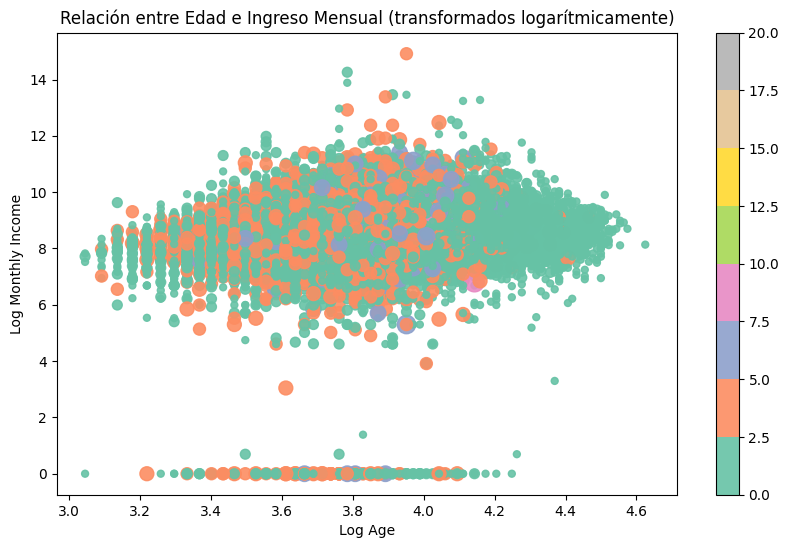

In [ ]:
# Transformamos a logaritmo las columnas de interés
log_age = np.log(training['age'])
log_monthly_income = np.log(training['MonthlyIncome'])

plt.figure(figsize=(10, 6))
scatter = plt.scatter(x=log_age, 
                      y=log_monthly_income, 
                      alpha=0.9, 
                      s=training['NumberOfDependents'] * 25, 
                      c=training['NumberOfDependents'], 
                      cmap='Set2')

plt.colorbar(scatter)
plt.xlabel('Log Age')
plt.ylabel('Log Monthly Income')
plt.title('Relación entre Edad e Ingreso Mensual (transformados logarítmicamente)')
plt.show()

 *** COMENTARIOS ***

Interpretacion:

- Log Age = 3 equivale a e^3 = 20.1 años.

- El tamaño de los puntos (s=train_df['NumberOfDependents']*25) representa el número de dependientes. Los puntos más grandes indican un mayor número de dependientes, lo que añade una tercera dimensión de información.

- El color de los puntos (c=train_df.NumberOfDependents) también representa el número de dependientes, y el mapa de colores (cmap='Set2') facilita la diferenciación visual entre diferentes cantidades de dependientes.

- Gran disparidad en ingresos de los prestatarios, pues va desde log 0 a 14. Variabilidad más contenida en la edad, con un rango que es más fácil de interpretar y gestionar.

<Figure size 800x800 with 0 Axes>

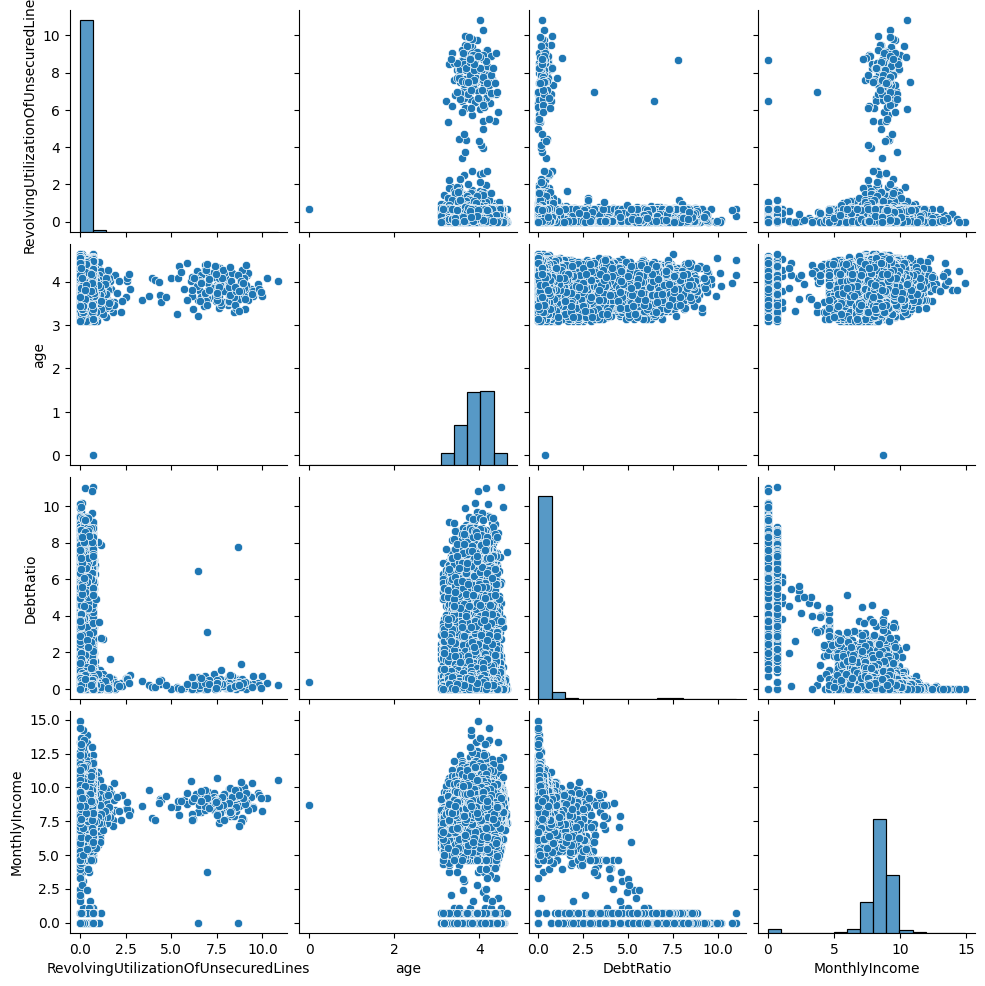

In [102]:
# Correlación entre variables numéricas - Pairplot
plt.figure(figsize=(8, 8))
sns.pairplot(np.log(training[['RevolvingUtilizationOfUnsecuredLines','age','DebtRatio','MonthlyIncome']]+1).dropna(axis=0,how='any'),
             diag_kws=dict(bins=15,edgecolor='black'))

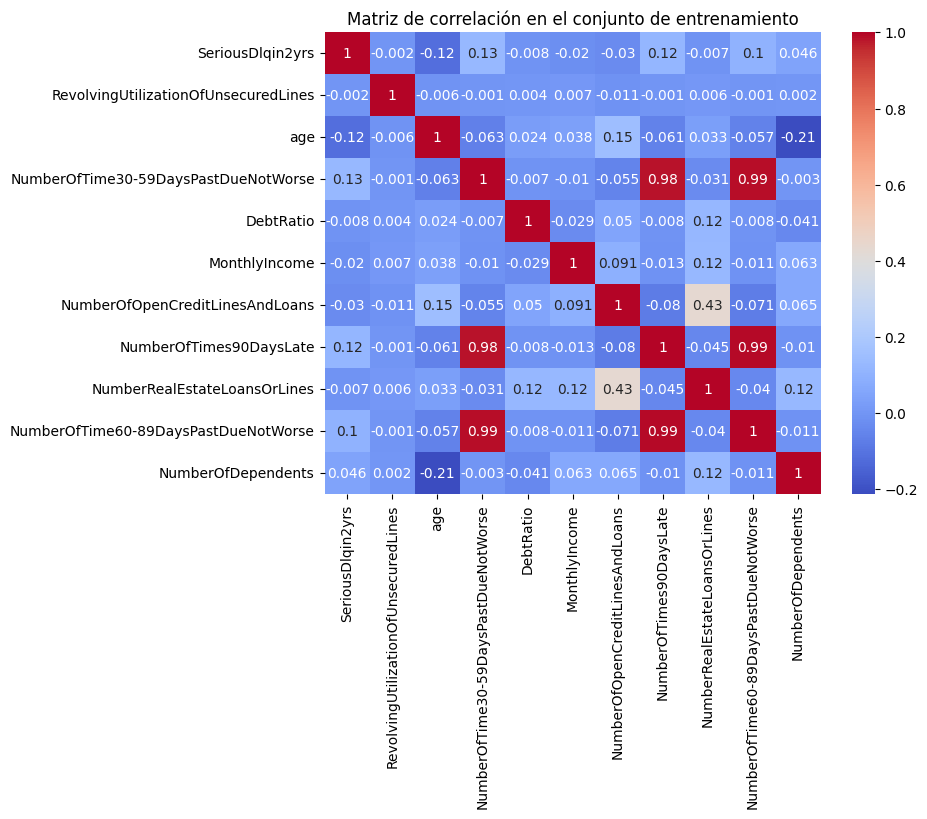

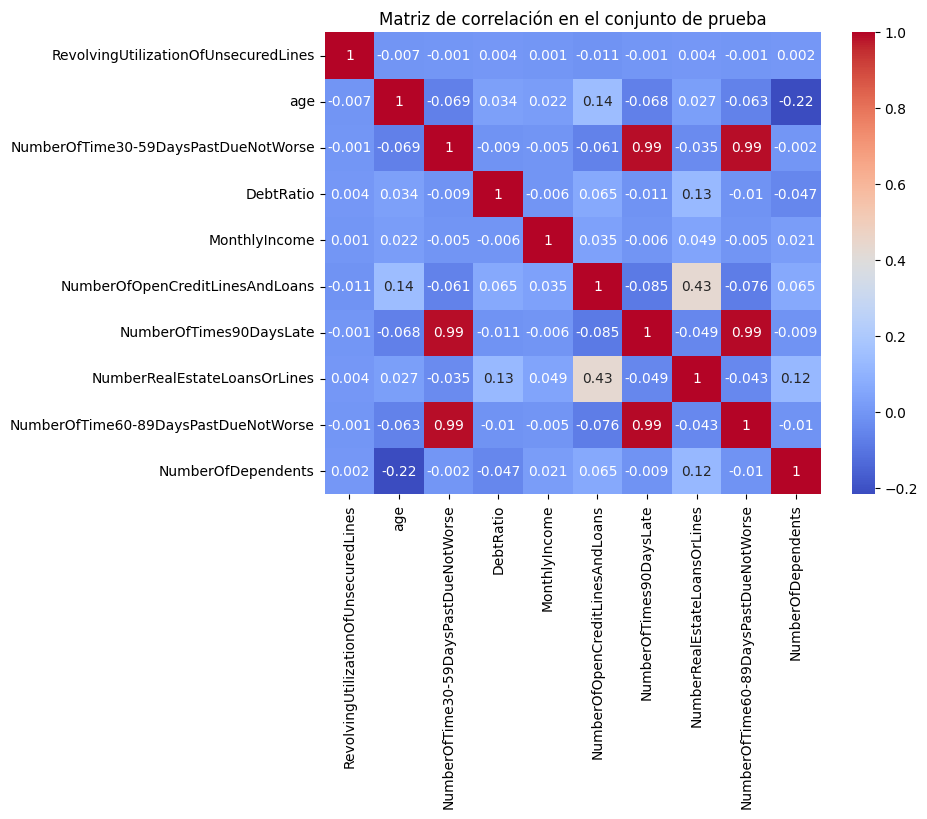

In [103]:
# Correlación entre variables numéricas - Mapa de calor
plt.figure(figsize=(8, 6))
sns.heatmap(training.drop(columns=['ID']).corr().round(3), annot=True, cmap='coolwarm') # Eliminar ID y redondear 2 decimales
plt.title('Matriz de correlación en el conjunto de entrenamiento')
plt.show()

plt.figure(figsize=(8, 6))
sns.heatmap(test.drop(columns=['ID' , 'SeriousDlqin2yrs']).corr().round(3), annot=True, cmap='coolwarm')
plt.title('Matriz de correlación en el conjunto de prueba')
plt.show()

# Identificacion de valores NA

In [104]:
# Determinando el % de valores NA en cada variable

# Función para calcular el porcentaje de valores nulos
def calcular_porcentaje_na(df):
    porcentaje_na = df.isnull().mean() * 100
    return porcentaje_na

# Calcular el porcentaje de valores nulos para training y test
NA_training = calcular_porcentaje_na(training).round(1)
NA_test = calcular_porcentaje_na(test).round(1)

# Imprimir los resultados
print("Porcentaje de valores NA en el conjunto de training:")
print(NA_training)

print("\nPorcentaje de valores NA en el conjunto de test:")
print(NA_test)

Porcentaje de valores NA en el conjunto de training:
ID                                       0.0
SeriousDlqin2yrs                         0.0
RevolvingUtilizationOfUnsecuredLines     0.0
age                                      0.0
NumberOfTime30-59DaysPastDueNotWorse     0.0
DebtRatio                                0.0
MonthlyIncome                           19.8
NumberOfOpenCreditLinesAndLoans          0.0
NumberOfTimes90DaysLate                  0.0
NumberRealEstateLoansOrLines             0.0
NumberOfTime60-89DaysPastDueNotWorse     0.0
NumberOfDependents                       2.6
dtype: float64

Porcentaje de valores NA en el conjunto de test:
ID                                        0.0
SeriousDlqin2yrs                        100.0
RevolvingUtilizationOfUnsecuredLines      0.0
age                                       0.0
NumberOfTime30-59DaysPastDueNotWorse      0.0
DebtRatio                                 0.0
MonthlyIncome                            19.8
NumberOfOpenCreditLi

En conjunto training y test, existen valores NA en las variables MonthlyIncome y NumberOfDependents.

# Identificacion de Outliers

In [105]:
# Empezamos graficando con diagramas de caja

# Excluir las columnas 'ID' y 'SeriousDlqin2yrs'
exclude_columns = ['ID', 'SeriousDlqin2yrs']
training_filtered = training.drop(columns=exclude_columns)
test_filtered = test.drop(columns=exclude_columns)

# Crear subgráficos para 'training' con 2 gráficos por fila
num_cols = 2
num_rows = (len(training_filtered.columns) + 1) // num_cols
fig_training = make_subplots(rows=num_rows, cols=num_cols, subplot_titles=training_filtered.columns)

for i, col in enumerate(training_filtered.columns):
    row = i // num_cols + 1
    col_num = i % num_cols + 1
    fig_training.add_trace(go.Box(y=training_filtered[col], name=col), row=row, col=col_num)

# Ajustar la altura y el diseño
fig_training.update_layout(
    height=150 * num_rows,  # Ajustar la altura según el número de filas
    width=800,  # Ajustar el ancho del gráfico
    title_text="Diagramas de Caja - DataFrame Training",
    showlegend=False
)

fig_training.show()

# Crear subgráficos para 'test' con 2 gráficos por fila
num_rows = (len(test_filtered.columns) + 1) // num_cols
fig_test = make_subplots(rows=num_rows, cols=num_cols, subplot_titles=test_filtered.columns)

for i, col in enumerate(test_filtered.columns):
    row = i // num_cols + 1
    col_num = i % num_cols + 1
    fig_test.add_trace(go.Box(y=test_filtered[col], name=col), row=row, col=col_num)

# Ajustar la altura y el diseño
fig_test.update_layout(
    height=150 * num_rows,  # Ajustar la altura según el número de filas
    width=800,  # Ajustar el ancho del gráfico
    title_text="Diagramas de Caja - DataFrame Test",
    showlegend=False
)

fig_test.show()

In [106]:
# Función para identificar los outliers más extremos
def identificar_outliers_extremos(df, target_variable='SeriousDlqin2yrs', exclude_columns=['ID']):
    outliers_dict = {}
    for column in df.columns:
        if column not in exclude_columns and column != target_variable and pd.api.types.is_numeric_dtype(df[column]):
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)][column]
            if not outliers.empty:
                min_outlier = outliers.min()
                max_outlier = outliers.max()
                outliers_dict[column] = (min_outlier, max_outlier)
    return outliers_dict

# Identificar los outliers más extremos en los DataFrames de training y test
outliers_extremos_training = identificar_outliers_extremos(training)
outliers_extremos_test = identificar_outliers_extremos(test)

# Crear tablas para cada DataFrame
def crear_tabla_outliers(df, outliers_dict, exclude_columns=['ID', 'SeriousDlqin2yrs']):
    data = []
    for column in df.columns:
        if column not in exclude_columns:
            if column in outliers_dict:
                min_outlier, max_outlier = outliers_dict[column]
            else:
                min_outlier, max_outlier = None, None
            promedio = df[column].mean() if pd.api.types.is_numeric_dtype(df[column]) else None
            data.append([column, promedio, min_outlier, max_outlier])
    return pd.DataFrame(data, columns=['Variable', 'Promedio', 'Outlier más bajo', 'Outlier más alto'])

tabla_outliers_training = crear_tabla_outliers(training, outliers_extremos_training).round(1)
tabla_outliers_test = crear_tabla_outliers(test, outliers_extremos_test).round(1)


In [107]:
tabla_outliers_training = crear_tabla_outliers(training, outliers_extremos_training).round(1)
tabla_outliers_training

,Variable,Promedio,Outlier más bajo,Outlier más alto
0,RevolvingUtilizationOfUnsecuredLines,6.0,1.4,50708.0
1,age,52.3,0.0,109.0
2,NumberOfTime30-59DaysPastDueNotWorse,0.4,1.0,98.0
3,DebtRatio,353.0,1.9,329664.0
4,MonthlyIncome,6670.2,15523.0,3008750.0
5,NumberOfOpenCreditLinesAndLoans,8.5,21.0,58.0
6,NumberOfTimes90DaysLate,0.3,1.0,98.0
7,NumberRealEstateLoansOrLines,1.0,6.0,54.0
8,NumberOfTime60-89DaysPastDueNotWorse,0.2,1.0,98.0
9,NumberOfDependents,0.8,3.0,20.0


In [108]:
tabla_outliers_test = crear_tabla_outliers(test, outliers_extremos_test).round(1)
tabla_outliers_test

,Variable,Promedio,Outlier más bajo,Outlier más alto
0,RevolvingUtilizationOfUnsecuredLines,5.3,1.4,21821.0
1,age,52.4,97.0,104.0
2,NumberOfTime30-59DaysPastDueNotWorse,0.5,1.0,98.0
3,DebtRatio,344.5,1.9,268326.0
4,MonthlyIncome,6855.0,15394.0,7727000.0
5,NumberOfOpenCreditLinesAndLoans,8.5,21.0,85.0
6,NumberOfTimes90DaysLate,0.3,1.0,98.0
7,NumberRealEstateLoansOrLines,1.0,6.0,37.0
8,NumberOfTime60-89DaysPastDueNotWorse,0.3,1.0,98.0
9,NumberOfDependents,0.8,3.0,43.0


In [109]:
# Función para identificar los outliers

def identificar_outliers(df, target_variable='SeriousDlqin2yrs', exclude_columns=['ID']):
    outliers_count_dict = {}
    for column in df.columns:
        if column not in exclude_columns and column != target_variable and pd.api.types.is_numeric_dtype(df[column]):
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            outliers_count = ((df[column] < lower_bound) | (df[column] > upper_bound)).sum()
            outliers_count_dict[column] = outliers_count
    return outliers_count_dict

# Identificar la cantidad de outliers en los DataFrames de training y test
outliers_count_training = identificar_outliers(training)
outliers_count_test = identificar_outliers(test)

# Crear un DataFrame que combine los resultados
outliers_summary_df = pd.DataFrame({
    'Variable': list(outliers_count_training.keys()),
    'Training': list(outliers_count_training.values()),
    'Training %': [outliers_count_training[var] / len(training) * 100 for var in outliers_count_training.keys()],
    'Test': list(outliers_count_test.values()),
    'Test %': [outliers_count_test[var] / len(test) * 100 for var in outliers_count_test.keys()]
}).round(2)

# Establecer la columna 'Variable' como índice
outliers_summary_df.set_index('Variable', inplace=True)

# Mostrar el DataFrame resultante
outliers_summary_df

# Exportar salida a excel
# outliers_summary_df.to_excel('outliers_summary_df.xlsx', index=True)




,Training,Training %,Test,Test %
Variable,,,,
RevolvingUtilizationOfUnsecuredLines,763,0.51,493,0.49
age,46,0.03,21,0.02
NumberOfTime30-59DaysPastDueNotWorse,23982,15.99,16313,16.07
DebtRatio,31311,20.87,21018,20.71
MonthlyIncome,4879,3.25,3368,3.32
NumberOfOpenCreditLinesAndLoans,3980,2.65,2699,2.66
NumberOfTimes90DaysLate,8338,5.56,5718,5.63
NumberRealEstateLoansOrLines,793,0.53,523,0.52
NumberOfTime60-89DaysPastDueNotWorse,7604,5.07,5128,5.05


# Analisis e imputacion por variable

### SeriousDlqin2yrs

In [ ]:
import plotly.express as px

# Calcular el porcentaje de 'SeriousDlqin2yrs'
percentages = training['SeriousDlqin2yrs'].value_counts(normalize=True) * 100

# Crear el gráfico de torta
fig = px.pie(values=percentages, 
             names=percentages.index, 
             title='Porcentaje de SeriousDlqin2yrs',
             labels={'index': 'SeriousDlqin2yrs', 'values': 'Porcentaje'},
             color=percentages.index, 
             color_discrete_map={0: 'lightblue', 1: 'red'},
             hole=0.3,
             width=800,
             )

# Personalizar la leyenda
fig.update_layout(
    legend_title_text='Default?',
    legend=dict(
        itemsizing='constant',
        title_font_size=16,
        font=dict(size=14)),
    plot_bgcolor='rgba(0,0,0,0)',  # Fondo transparente
    paper_bgcolor='rgba(0,0,0,0)'  # Fondo transparente
)


# Actualizar etiquetas de la leyenda de manera segura
name_mapping = {'0': 'No', '1': 'Sí'}
fig.for_each_trace(lambda t: t.update(name=name_mapping.get(str(t.name), t.name)))

# Mostrar el gráfico
fig.show()



### RevolvingUtilizationOfUnsecuredLines
Representa la relación entre el dinero adeudado y el límite de crédito, por lo que no debería estar muy por encima de 1.

In [111]:
# Validacion de outliers para RevolvingUtilizationOfUnsecuredLines

training[(training['RevolvingUtilizationOfUnsecuredLines'] > .9) & 
         (training['RevolvingUtilizationOfUnsecuredLines'] <= 4)].SeriousDlqin2yrs.describe().round(1)

training[(training['RevolvingUtilizationOfUnsecuredLines'] > 4) & 
         (training['RevolvingUtilizationOfUnsecuredLines'] <= 10)].SeriousDlqin2yrs.describe().round(1)

training[training['RevolvingUtilizationOfUnsecuredLines'] > 10].describe().round(2)

,ID,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,241.00,241.00,241.00,241.00,241.00,241.00,173.00,241.00,241.00,241.00,241.00,228.00
mean,77655.00,0.07,3564.02,50.63,0.19,571.92,8467.67,5.76,0.07,1.19,0.09,0.69
std,41010.85,0.26,5123.80,14.57,0.58,1772.95,6564.07,3.11,0.58,1.07,0.56,1.04
min,294.00,0.00,11.39,24.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00
25%,44564.00,0.00,941.00,39.00,0.00,0.22,4500.00,4.00,0.00,0.00,0.00,0.00
50%,80200.00,0.00,2012.00,48.00,0.00,0.40,7000.00,5.00,0.00,1.00,0.00,0.00
75%,111663.00,0.00,4116.00,62.00,0.00,59.00,10091.00,7.00,0.00,2.00,0.00,1.00
max,149280.00,1.00,50708.00,87.00,3.00,21395.00,44472.00,21.00,8.00,9.00,7.00,4.00


Existen 241 personas que practicamente no están en mora, teniendo en cuenta que algunas de ellas deben cientos de miles de veces sus límites de crédito. Esto sugiere inconsistencia en los datos, con lo cual se pueden eliminar.

In [112]:
# Verificacion previa
print(f"Count before: {(training['RevolvingUtilizationOfUnsecuredLines'] > 10).sum()}")

# Eliminar outliers
training.drop(training[training['RevolvingUtilizationOfUnsecuredLines'] > 10].index)

# Verificacion posterior
print(f"Count after: {(training['age'] == 0).sum()}")


Count before: 241
Count after: 1


In [113]:
training[training['RevolvingUtilizationOfUnsecuredLines'] > 10].describe()

,ID,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,241.000000,241.000000,241.000000,241.000000,241.000000,241.000000,173.00000,241.000000,241.000000,241.000000,241.000000,228.000000
mean,77655.004149,0.070539,3564.023932,50.630705,0.186722,571.918644,8467.67052,5.763485,0.074689,1.186722,0.087137,0.688596
std,41010.846073,0.256587,5123.802683,14.565389,0.579502,1772.948412,6564.06825,3.114160,0.579711,1.065750,0.559651,1.038659
min,294.000000,0.000000,11.385230,24.000000,0.000000,0.000800,0.00000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,44564.000000,0.000000,941.000000,39.000000,0.000000,0.217813,4500.00000,4.000000,0.000000,0.000000,0.000000,0.000000
50%,80200.000000,0.000000,2012.000000,48.000000,0.000000,0.402560,7000.00000,5.000000,0.000000,1.000000,0.000000,0.000000
75%,111663.000000,0.000000,4116.000000,62.000000,0.000000,59.000000,10091.00000,7.000000,0.000000,2.000000,0.000000,1.000000
max,149280.000000,1.000000,50708.000000,87.000000,3.000000,21395.000000,44472.00000,21.000000,8.000000,9.000000,7.000000,4.000000


### Age

In [114]:
# Verificacion previa
print(training.loc[training['age'] == 0].head(5).to_string(index=False, header=True))
print(test.loc[test['age'] == 0].head(5).to_string(index=False, header=True))


print('\n' , f"Count before in training: {(training['age'] == 0).sum()}" , 
      '\n' , f"Median: {training['age'].median()}")

print('\n' , f"Count before in test: {(test['age'] == 0).sum()}" , 
      '\n' , f"Median: {test['age'].median()}")

# Reemplazar los valores NaN en age con la mediana
training['age'] = training['age'].replace(0, training['age'].median())
test['age'] = test['age'].replace(0, test['age'].median())

# Verificacion posterior
print('\n' , f"After in training: {(training['age'] == 0).sum()}" , 
      '\n' , f"After in test: {(test['age'] == 0).sum()}")

   ID  SeriousDlqin2yrs  RevolvingUtilizationOfUnsecuredLines  age  NumberOfTime30-59DaysPastDueNotWorse  DebtRatio  MonthlyIncome  NumberOfOpenCreditLinesAndLoans  NumberOfTimes90DaysLate  NumberRealEstateLoansOrLines  NumberOfTime60-89DaysPastDueNotWorse  NumberOfDependents
65696                 0                                   1.0    0                                     1   0.436927         6000.0                                6                        0                             2                                     0                 2.0
Empty DataFrame
Columns: [ID, SeriousDlqin2yrs, RevolvingUtilizationOfUnsecuredLines, age, NumberOfTime30-59DaysPastDueNotWorse, DebtRatio, MonthlyIncome, NumberOfOpenCreditLinesAndLoans, NumberOfTimes90DaysLate, NumberRealEstateLoansOrLines, NumberOfTime60-89DaysPastDueNotWorse, NumberOfDependents]
Index: []

 Count before in training: 1 
 Median: 52.0

 Count before in test: 0 
 Median: 52.0

 After in training: 0 
 After in test: 0


## Variables NumberOfTime...DaysPastDueNotWorse
There are 3 variables

### NumberOfTime30-59DaysPastDueNotWorse


In [115]:
training['NumberOfTime30-59DaysPastDueNotWorse'].value_counts().sort_index()


NumberOfTime30-59DaysPastDueNotWorse
0     126018
1      16033
2       4598
3       1754
4        747
5        342
6        140
7         54
8         25
9         12
10         4
11         1
12         2
13         1
96         5
98       264
Name: count, dtype: int64

### NumberOfTimes90DaysLate

In [116]:
training['NumberOfTimes90DaysLate'].value_counts().sort_index()


NumberOfTimes90DaysLate
0     141662
1       5243
2       1555
3        667
4        291
5        131
6         80
7         38
8         21
9         19
10         8
11         5
12         2
13         4
14         2
15         2
17         1
96         5
98       264
Name: count, dtype: int64

### NumberOfTime60-89DaysPastDueNotWorse


In [117]:
training['NumberOfTime60-89DaysPastDueNotWorse'].value_counts().sort_index()


NumberOfTime60-89DaysPastDueNotWorse
0     142396
1       5731
2       1118
3        318
4        105
5         34
6         16
7          9
8          2
9          1
11         1
96         5
98       264
Name: count, dtype: int64

### Set imputation

In [118]:
# Función para reemplazar outliers con la mediana y contar reemplazos
def reemplazar_outliers(data):
    new_data = data[data != 96]
    new_data = new_data[new_data != 98]
    new = []
    newval = new_data.median()
    count_replacements = 0
    for i in data:
        if i == 96 or i == 98:
            new.append(newval)
            count_replacements += 1
        else:
            new.append(i)
    return new, count_replacements

# Reemplazar outliers y contar reemplazos
training['NumberOfTime30-59DaysPastDueNotWorse'], count_30_59 = reemplazar_outliers(training['NumberOfTime30-59DaysPastDueNotWorse'])
training['NumberOfTimes90DaysLate'], count_90 = reemplazar_outliers(training['NumberOfTimes90DaysLate'])
training['NumberOfTime60-89DaysPastDueNotWorse'], count_60_89 = reemplazar_outliers(training['NumberOfTime60-89DaysPastDueNotWorse'])

# Verificación de eliminación de outliers
print(f'Número de reemplazos en NumberOfTime30-59DaysPastDueNotWorse: {count_30_59}')
print(f'Número de reemplazos en NumberOfTimes90DaysLate: {count_90}')
print(f'Número de reemplazos en NumberOfTime60-89DaysPastDueNotWorse: {count_60_89}')

print('\nConteo: ', training['NumberOfTime30-59DaysPastDueNotWorse'].value_counts().sort_index())
print('\nConteo: ', training['NumberOfTime60-89DaysPastDueNotWorse'].value_counts().sort_index())
print('\nConteo: ', training['NumberOfTimes90DaysLate'].value_counts().sort_index())

Número de reemplazos en NumberOfTime30-59DaysPastDueNotWorse: 269
Número de reemplazos en NumberOfTimes90DaysLate: 269
Número de reemplazos en NumberOfTime60-89DaysPastDueNotWorse: 269

Conteo:  NumberOfTime30-59DaysPastDueNotWorse
0.0     126287
1.0      16033
2.0       4598
3.0       1754
4.0        747
5.0        342
6.0        140
7.0         54
8.0         25
9.0         12
10.0         4
11.0         1
12.0         2
13.0         1
Name: count, dtype: int64

Conteo:  NumberOfTime60-89DaysPastDueNotWorse
0.0     142665
1.0       5731
2.0       1118
3.0        318
4.0        105
5.0         34
6.0         16
7.0          9
8.0          2
9.0          1
11.0         1
Name: count, dtype: int64

Conteo:  NumberOfTimes90DaysLate
0.0     141931
1.0       5243
2.0       1555
3.0        667
4.0        291
5.0        131
6.0         80
7.0         38
8.0         21
9.0         19
10.0         8
11.0         5
12.0         2
13.0         4
14.0         2
15.0         2
17.0         1
Name:

## DebtRatio

In [119]:
training.DebtRatio.describe()

count    150000.000000
mean        353.005076
std        2037.818523
min           0.000000
25%           0.175074
50%           0.366508
75%           0.868254
max      329664.000000
Name: DebtRatio, dtype: float64

Es muy extraño que alguien deba casi 353.000 veces lo que posee, segun el DebtRatio. Tambien los valores muy elevados de las demas varibales, indica la presencia de outliers.

In [120]:
training.DebtRatio.quantile([.975])

0.975    3489.025
Name: DebtRatio, dtype: float64

El 2,5% del conjunto de datos debe más de 3.500 veces lo que posee.

In [121]:
training[training['DebtRatio'] > 3489.025][['SeriousDlqin2yrs','MonthlyIncome']].describe()

,SeriousDlqin2yrs,MonthlyIncome
count,3750.000000,185.000000
mean,0.064267,0.064865
std,0.245260,0.246956
min,0.000000,0.000000
25%,0.000000,0.000000
50%,0.000000,0.000000
75%,0.000000,0.000000
max,1.000000,1.000000


Vemos que de 3750 registros con DebtRatio > 3489, sólo 185 tienen un valor de ingreso mensual. Además, las personas que sí tienen ingresos mensuales parecen tener un ingreso mensual de 1 o 0. segun la media de MonthlyIncome.

In [122]:
training[(training['DebtRatio'] > 3489.025) & (training['SeriousDlqin2yrs'] == training['MonthlyIncome'])].shape[0]

164

Se identificaron 4,000 registros con una razón de endeudamiento extremadamente alta (>3489). De estos, solo 185 tienen ingresos mensuales registrados, y muchos de esos ingresos son sospechosamente bajos (1 o 0). Además, en 164 casos, los ingresos coinciden exactamente con la tasa de incumplimiento, lo que sugiere errores en la entrada de datos. A pesar de su alto endeudamiento, estas personas no incumplen más que el promedio, lo cual es inconsistente. Debido a estas anomalías, se concluye que estos registros son errores y se pueden eliminar del modelo.

In [123]:
# Verificacion previa
print('\n' , f"Count before: {(training['DebtRatio'] > 3489.025).sum()}" , 
      '\n' , f"Median: {training['DebtRatio'].median()}")

# reemplazar el registro de DebtRatio > 3489.025 con la mediana 
training.loc[training['DebtRatio'] > 3489.025, 'DebtRatio'] = training['DebtRatio'].mean()

# Verificacion posterior
print(f"After in training: {(training['DebtRatio'] > 3489.025).sum()}")


 Count before: 3750 
 Median: 0.366507841
After in training: 0


## MonthlyIncome

In [124]:
# Verificacion previa
print(training.loc[training['MonthlyIncome'].isnull()].head(5).to_string(index=False, header=True))
print(test.loc[test['MonthlyIncome'].isnull()].head(5).to_string(index=False, header=True))


print('\n' , f"Count before in training: {(training['MonthlyIncome'].isnull()).sum()}" , 
      '\n' , f"Mean: {training['MonthlyIncome'].mean()}")

print('\n' , f"Count before in test: {(test['MonthlyIncome'].isnull()).sum()}" , 
      '\n' , f"Mean: {test['MonthlyIncome'].mean()}")

# Reemplazar los valores NaN en MonthlyIncome con la mediana
training['MonthlyIncome'] = training['MonthlyIncome'].replace(np.nan, training['MonthlyIncome'].mean())
test['MonthlyIncome'] = test['MonthlyIncome'].replace(np.nan, test['MonthlyIncome'].mean())

# Verificacion posterior
print('\n' , f"After in training: {(training['MonthlyIncome'].isnull()).sum()}" , 
      '\n' , f"After in test: {(test['MonthlyIncome'].isnull()).sum()}")

 ID  SeriousDlqin2yrs  RevolvingUtilizationOfUnsecuredLines  age  NumberOfTime30-59DaysPastDueNotWorse   DebtRatio  MonthlyIncome  NumberOfOpenCreditLinesAndLoans  NumberOfTimes90DaysLate  NumberRealEstateLoansOrLines  NumberOfTime60-89DaysPastDueNotWorse  NumberOfDependents
  7                 0                              0.305682   57                                   0.0  353.005076            NaN                                8                      0.0                             3                                   0.0                 0.0
  9                 0                              0.116951   27                                   0.0   46.000000            NaN                                2                      0.0                             0                                   0.0                 NaN
 17                 0                              0.061086   78                                   0.0 2058.000000            NaN                               10          

In [125]:
import plotly.express as px

# Crear el diagrama de caja para la columna 'MonthlyIncome'
fig = px.box(training, x='MonthlyIncome', title='Diagrama de Caja para MonthlyIncome (Training)')

# Mostrar el gráfico
fig.show()

In [126]:
# Filtrar los registros donde 'MonthlyIncome' es mayor a 1,000,000
filtered_df = training[training['MonthlyIncome'] > 1000000]

# Contar los registros filtrados
count_filtered = filtered_df.shape[0]

# Mostrar los registros filtrados y el conteo
print("Registros donde 'MonthlyIncome' es mayor a 1,000,000:")
print(filtered_df.to_string(index=False, header=True))
print(f"\nCantidad de registros: {count_filtered}")

Registros donde 'MonthlyIncome' es mayor a 1,000,000:
    ID  SeriousDlqin2yrs  RevolvingUtilizationOfUnsecuredLines  age  NumberOfTime30-59DaysPastDueNotWorse  DebtRatio  MonthlyIncome  NumberOfOpenCreditLinesAndLoans  NumberOfTimes90DaysLate  NumberRealEstateLoansOrLines  NumberOfTime60-89DaysPastDueNotWorse  NumberOfDependents
 50641                 0                              0.469025   44                                   1.0   0.004537      1072500.0                                9                      0.0                             2                                   0.0                 1.0
 73764                 0                              0.007328   52                                   0.0   0.001470      3008750.0                               10                      0.0                             1                                   0.0                 3.0
111366                 0                              0.163856   44                                   0.0   0.00

## NumberOfDependents

In [127]:
training['NumberOfDependents'].value_counts().sort_index()

NumberOfDependents
0.0     86902
1.0     26316
2.0     19522
3.0      9483
4.0      2862
5.0       746
6.0       158
7.0        51
8.0        24
9.0         5
10.0        5
13.0        1
20.0        1
Name: count, dtype: int64

In [128]:
# Verificacion previa
print(training.loc[training['NumberOfDependents'].isnull()].head(5).to_string(index=False, header=True))
print(test.loc[test['NumberOfDependents'].isnull()].head(5).to_string(index=False, header=True))


print('\n' , f"Count before in training: {(training['NumberOfDependents'].isnull()).sum()}" , 
      '\n' , f"Median: {training['NumberOfDependents'].median()}")

print('\n' , f"Count before in test: {(test['NumberOfDependents'].isnull()).sum()}" , 
      '\n' , f"Median: {test['NumberOfDependents'].median()}")

# Reemplazar los valores NaN en NumberOfDependents con la mediana
training['NumberOfDependents'] = training['NumberOfDependents'].replace(np.nan, training['NumberOfDependents'].median())
test['NumberOfDependents'] = test['NumberOfDependents'].replace(np.nan, test['NumberOfDependents'].median())

# Verificacion posterior
print('\n' , f"After in training: {(training['NumberOfDependents'].isnull()).sum()}" , 
      '\n' , f"After in test: {(test['NumberOfDependents'].isnull()).sum()}")

 ID  SeriousDlqin2yrs  RevolvingUtilizationOfUnsecuredLines  age  NumberOfTime30-59DaysPastDueNotWorse  DebtRatio  MonthlyIncome  NumberOfOpenCreditLinesAndLoans  NumberOfTimes90DaysLate  NumberRealEstateLoansOrLines  NumberOfTime60-89DaysPastDueNotWorse  NumberOfDependents
  9                 0                              0.116951   27                                   0.0  46.000000    6670.221237                                2                      0.0                             0                                   0.0                 NaN
 97                 0                              0.542243   48                                   2.0  10.000000    6670.221237                                2                      0.0                             0                                   0.0                 NaN
110                 0                              0.041258   61                                   0.0 353.005076    6670.221237                               11              

# Verificacion de training y test modificados

In [129]:
# Determinando el % de valores NA en cada variable

# Función para calcular el porcentaje de valores nulos
def calcular_porcentaje_na(df):
    porcentaje_na = df.isnull().mean() * 100
    return porcentaje_na

# Calcular el porcentaje de valores nulos para training y test
NA_training = calcular_porcentaje_na(training).round(1)
NA_test = calcular_porcentaje_na(test).round(1)

# Imprimir los resultados
print("Porcentaje de valores NA en el conjunto de training:")
print(NA_training)

print("\nPorcentaje de valores NA en el conjunto de test:")
print(NA_test)

Porcentaje de valores NA en el conjunto de training:
ID                                      0.0
SeriousDlqin2yrs                        0.0
RevolvingUtilizationOfUnsecuredLines    0.0
age                                     0.0
NumberOfTime30-59DaysPastDueNotWorse    0.0
DebtRatio                               0.0
MonthlyIncome                           0.0
NumberOfOpenCreditLinesAndLoans         0.0
NumberOfTimes90DaysLate                 0.0
NumberRealEstateLoansOrLines            0.0
NumberOfTime60-89DaysPastDueNotWorse    0.0
NumberOfDependents                      0.0
dtype: float64

Porcentaje de valores NA en el conjunto de test:
ID                                        0.0
SeriousDlqin2yrs                        100.0
RevolvingUtilizationOfUnsecuredLines      0.0
age                                       0.0
NumberOfTime30-59DaysPastDueNotWorse      0.0
DebtRatio                                 0.0
MonthlyIncome                             0.0
NumberOfOpenCreditLinesAndLoans 

In [130]:
# Función para identificar los outliers más extremos
def identificar_outliers_extremos(df, target_variable='SeriousDlqin2yrs', exclude_columns=['ID']):
    outliers_dict = {}
    for column in df.columns:
        if column not in exclude_columns and column != target_variable and pd.api.types.is_numeric_dtype(df[column]):
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)][column]
            if not outliers.empty:
                min_outlier = outliers.min()
                max_outlier = outliers.max()
                outliers_dict[column] = (min_outlier, max_outlier)
    return outliers_dict

# Identificar los outliers más extremos en los DataFrames de training y test
outliers_extremos_training = identificar_outliers_extremos(training)
outliers_extremos_test = identificar_outliers_extremos(test)

# Crear tablas para cada DataFrame
def crear_tabla_outliers(df, outliers_dict, exclude_columns=['ID', 'SeriousDlqin2yrs']):
    data = []
    for column in df.columns:
        if column not in exclude_columns:
            if column in outliers_dict:
                min_outlier, max_outlier = outliers_dict[column]
            else:
                min_outlier, max_outlier = None, None
            promedio = df[column].mean() if pd.api.types.is_numeric_dtype(df[column]) else None
            data.append([column, promedio, min_outlier, max_outlier])
    return pd.DataFrame(data, columns=['Variable', 'Promedio', 'Outlier más bajo', 'Outlier más alto'])

tabla_outliers_training = crear_tabla_outliers(training, outliers_extremos_training).round(1)
tabla_outliers_test = crear_tabla_outliers(test, outliers_extremos_test).round(1)


tabla_outliers_training = crear_tabla_outliers(training, outliers_extremos_training).round(1)
tabla_outliers_training


,Variable,Promedio,Outlier más bajo,Outlier más alto
0,RevolvingUtilizationOfUnsecuredLines,6.0,1.4,50708.0
1,age,52.3,97.0,109.0
2,NumberOfTime30-59DaysPastDueNotWorse,0.2,1.0,13.0
3,DebtRatio,213.9,1.9,3489.0
4,MonthlyIncome,6670.2,12646.0,3008750.0
5,NumberOfOpenCreditLinesAndLoans,8.5,21.0,58.0
6,NumberOfTimes90DaysLate,0.1,1.0,17.0
7,NumberRealEstateLoansOrLines,1.0,6.0,54.0
8,NumberOfTime60-89DaysPastDueNotWorse,0.1,1.0,11.0
9,NumberOfDependents,0.7,3.0,20.0


# Importar y exportar df original y modificados

In [131]:
# Traer df originales de nuevo
training_original = df_training.copy()
test_original = df_test.copy()

# Generar copia de df modificadso en el preprocesamiento
training_modified = training.copy()
test_modified = test.copy()

# Exportar / guardar archivo de df modificados
training_modified.to_csv('training_modified.csv', index=False)
test_modified.to_csv('test_modified.csv', index=False)


print('Se ha cargado la BD exitosamente, sos un crack !')
print('Cantidad de registros:', training_modified.shape[0])

Se ha cargado la BD exitosamente, sos un crack !
Cantidad de registros: 150000


# Modelo de Testeo
Se ha extraido de: https://www.kaggle.com/code/simonpfish/comp-stats-group-data-project-final/notebook

Este permite probar rápidamente modelos y conjuntos de datos para compararlos entre sí. Este se ejecuta automáticamente con una validación cruzada de k veces en modelos scikit en diferentes conjuntos de datos.

In [132]:


# A utility class to test all of our models on different datasets
class Tester():
    def __init__(self, target):
        self.target = target
        self.datasets = {}
        self.models = {}
        self.cache = {} # we added a simple cache to speed things up

    def addDataset(self, name, df):
        self.datasets[name] = df.copy()

    def addModel(self, name, model):
        self.models[name] = model
        
    def clearModels(self):
        self.models = {}

    def clearCache(self):
        self.cache = {}
    
    def testModelWithDataset(self, m_name, df_name, sample_len, cv):
        if (m_name, df_name, sample_len, cv) in self.cache:
            return self.cache[(m_name, df_name, sample_len, cv)]

        clf = self.models[m_name]
        
        if not sample_len: 
            sample = self.datasets[df_name]
        else: sample = self.datasets[df_name].sample(sample_len)
            
        X = sample.drop([self.target], axis=1)
        Y = sample[self.target]

        s = cross_validate(clf, X, Y, scoring=['roc_auc'], cv=cv, n_jobs=-1)
        self.cache[(m_name, df_name, sample_len, cv)] = s

        return s

    def runTests(self, sample_len=120000, cv=10): # *** SE HA INCREMENTADO SEGUN TAMAÑO MUESTRA Y CV (VALIDACION CRUZADA)
        # Tests the added models on all the added datasets
        scores = {}
        for m_name in self.models:
            for df_name in self.datasets:
                # print('Testing %s' % str((m_name, df_name)), end='')
                start = time.time()

                score = self.testModelWithDataset(m_name, df_name, sample_len, cv)
                scores[(m_name, df_name)] = score
                
                end = time.time()
                
                # print(' -- %0.2fs ' % (end - start))

        print('--- Top 10 Results ---')
        for score in sorted(scores.items(), key=lambda x: -1 * x[1]['test_roc_auc'].mean())[:10]:
            auc = score[1]['test_roc_auc']
            print("%s --> AUC: %0.4f (+/- %0.4f)" % (str(score[0]), auc.mean(), auc.std()))

            
# We will use a tester object across all models
tester = Tester('SeriousDlqin2yrs')

# Agregar los conjuntos de datos
tester.addDataset('Drop Missing', training_original.dropna())
tester.addDataset('Median Fill', training_original.fillna(training_original.median()))
tester.addDataset('Median Fill, Outliers Removed', training_modified)

# Agregar los modelos
rfc = RandomForestClassifier(n_estimators=15, max_depth=6, random_state=0)
svm_model = LinearSVC()
xgb_model = xgb.XGBClassifier(n_estimators=100, max_depth=6, random_state=0, use_label_encoder=False, eval_metric='logloss')
mlp_model = MLPClassifier(hidden_layer_sizes=(100,), max_iter=300, random_state=0)


tester.addModel('Simple Random Forest', rfc)
tester.addModel('Simple SVM', svm_model)
tester.addModel('XGBoost', xgb_model)
tester.addModel('Neural Network', mlp_model)

# You can then use it to run the tests
tester.runTests()

--- Top 10 Results ---
('Simple Random Forest', 'Median Fill') --> AUC: 0.8582 (+/- 0.0058)
('Simple Random Forest', 'Median Fill, Outliers Removed') --> AUC: 0.8580 (+/- 0.0048)
('XGBoost', 'Median Fill, Outliers Removed') --> AUC: 0.8545 (+/- 0.0094)
('XGBoost', 'Median Fill') --> AUC: 0.8531 (+/- 0.0048)
('Simple Random Forest', 'Drop Missing') --> AUC: 0.8492 (+/- 0.0074)
('XGBoost', 'Drop Missing') --> AUC: 0.8461 (+/- 0.0086)
('Simple SVM', 'Median Fill, Outliers Removed') --> AUC: 0.6465 (+/- 0.0123)
('Simple SVM', 'Median Fill') --> AUC: 0.6443 (+/- 0.0116)
('Simple SVM', 'Drop Missing') --> AUC: 0.6302 (+/- 0.0079)
('Neural Network', 'Median Fill, Outliers Removed') --> AUC: 0.6272 (+/- 0.0919)


In [133]:
tester.addDataset('Median Fill', training_original.fillna(training_original.median()))
tester.addDataset('Median Fill, Outliers Removed', training_modified)

tester.runTests()

--- Top 10 Results ---
('Simple Random Forest', 'Median Fill') --> AUC: 0.8582 (+/- 0.0058)
('Simple Random Forest', 'Median Fill, Outliers Removed') --> AUC: 0.8580 (+/- 0.0048)
('XGBoost', 'Median Fill, Outliers Removed') --> AUC: 0.8545 (+/- 0.0094)
('XGBoost', 'Median Fill') --> AUC: 0.8531 (+/- 0.0048)
('Simple Random Forest', 'Drop Missing') --> AUC: 0.8492 (+/- 0.0074)
('XGBoost', 'Drop Missing') --> AUC: 0.8461 (+/- 0.0086)
('Simple SVM', 'Median Fill, Outliers Removed') --> AUC: 0.6465 (+/- 0.0123)
('Simple SVM', 'Median Fill') --> AUC: 0.6443 (+/- 0.0116)
('Simple SVM', 'Drop Missing') --> AUC: 0.6302 (+/- 0.0079)
('Neural Network', 'Median Fill, Outliers Removed') --> AUC: 0.6272 (+/- 0.0919)


Modelos utilizados:

- Simple Random Forest: Un modelo de bosque aleatorio con 15 árboles (n_estimators=15) y una profundidad máxima de 6 (max_depth=6). Este modelo es un clasificador robusto que generalmente funciona bien en muchos tipos de datos, especialmente cuando hay relaciones no lineales entre las características.

- Simple SVM: Un clasificador SVM lineal (svm.LinearSVC). Los SVM son buenos para separar clases en un espacio de alta dimensionalidad, pero un SVM lineal puede no ser el más adecuado si los datos no son linealmente separables.

Conjuntos de datos:

- Drop Missing: Un conjunto de datos en el que se han eliminado todas las filas con valores faltantes (dropna()).
- Median Fill: Un conjunto de datos donde los valores faltantes han sido rellenados con la mediana de cada columna (fillna(training_original.median())).
- Median Fill, Outliers Removed: Un conjunto de datos donde además de rellenar los valores faltantes con la mediana, se han eliminado los valores atípicos (outliers).

Métrica:

- AUC (Área Bajo la Curva ROC): Mide la capacidad del modelo para distinguir entre las clases. Un AUC de 0.5 indica que el modelo no tiene capacidad discriminativa (es decir, es equivalente a una clasificación aleatoria), mientras que un AUC de 1.0 indica una clasificación perfecta. A continuacion se explica al detalle:

    - Menor a 0.5 es un mal desempeño (el modelo es peor que el azar)
    - Entre 0.5 y 0.7 es un desempeño regular (el modelo es ligeramente mejor que el azar)
    - Entre 0.7 y 0.8 es un desempeño bueno (el modelo es significativamente mejor que el azar)
    - Entre 0.8 y 0.9 es un desempeño muy bueno (el modelo es muy preciso)
    - Mayor a 0.9 es un desempeño excelente (el modelo es casi perfecto)

Resultados obtenidos:

Simple Random Forest:
- 'Drop Missing': AUC = 0.8518 (+/- 0.0040)
- 'Median Fill, Outliers Removed': AUC = 0.8580 (+/- 0.0041)
- 'Median Fill': AUC = 0.8566 (+/- 0.0049)

Interpretación:

El modelo de Random Forest parece funcionar consistentemente bien en todos los conjuntos de datos. El AUC es alto (alrededor de 0.85-0.86), lo que indica una buena capacidad de discriminación. Cuando se rellenan los valores faltantes con la mediana y se eliminan los outliers (Median Fill, Outliers Removed), el rendimiento es ligeramente mejor que en los otros conjuntos de datos. Esto sugiere que la limpieza de los datos y la eliminación de outliers pueden estar ayudando al modelo a generalizar mejor.

Simple SVM:
- 'Drop Missing': AUC = 0.5776 (+/- 0.0151)
- 'Median Fill, Outliers Removed': AUC = 0.5959 (+/- 0.0293)
- 'Median Fill': AUC = 0.5759 (+/- 0.0594)

Interpretación:

El modelo SVM tiene un rendimiento significativamente peor que el Random Forest, con AUC alrededor de 0.57-0.59. Esto sugiere que el SVM lineal no es capaz de capturar la complejidad de los datos tan bien como el Random Forest. El mejor rendimiento del SVM se observa en el conjunto de datos Median Fill, Outliers Removed, lo cual es consistente con la mejora vista en el modelo de Random Forest. Sin embargo, la mejora es mucho menor, y el modelo sigue teniendo un rendimiento relativamente pobre.

Conclusión:

-Random Forest es claramente el modelo superior en este caso, mostrando una buena capacidad predictiva en todos los conjuntos de datos.
-SVM lineal no parece ser una buena opción para estos datos, ya que su rendimiento es cercano a la clasificación aleatoria (AUC ~ 0.57-0.59).
-La eliminación de outliers y el relleno de valores faltantes parecen mejorar ligeramente el rendimiento de los modelos, lo cual es una indicación de que la calidad del preprocesamiento de datos afecta de manera positiva los resultados.


# EDA luego de limpieza

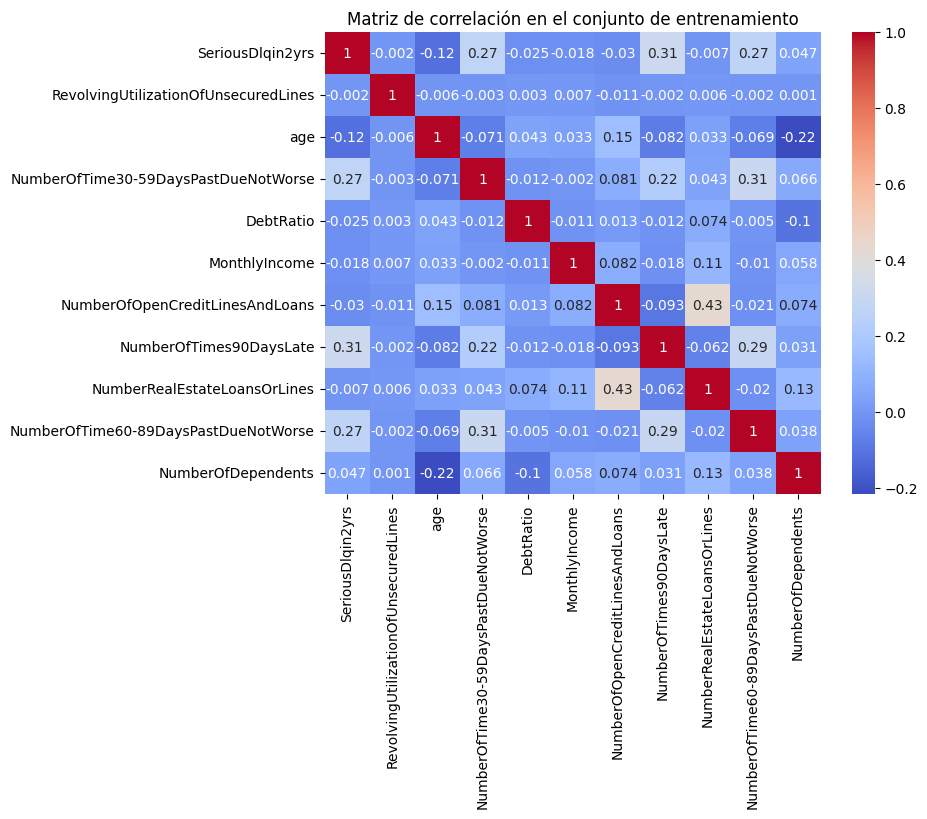

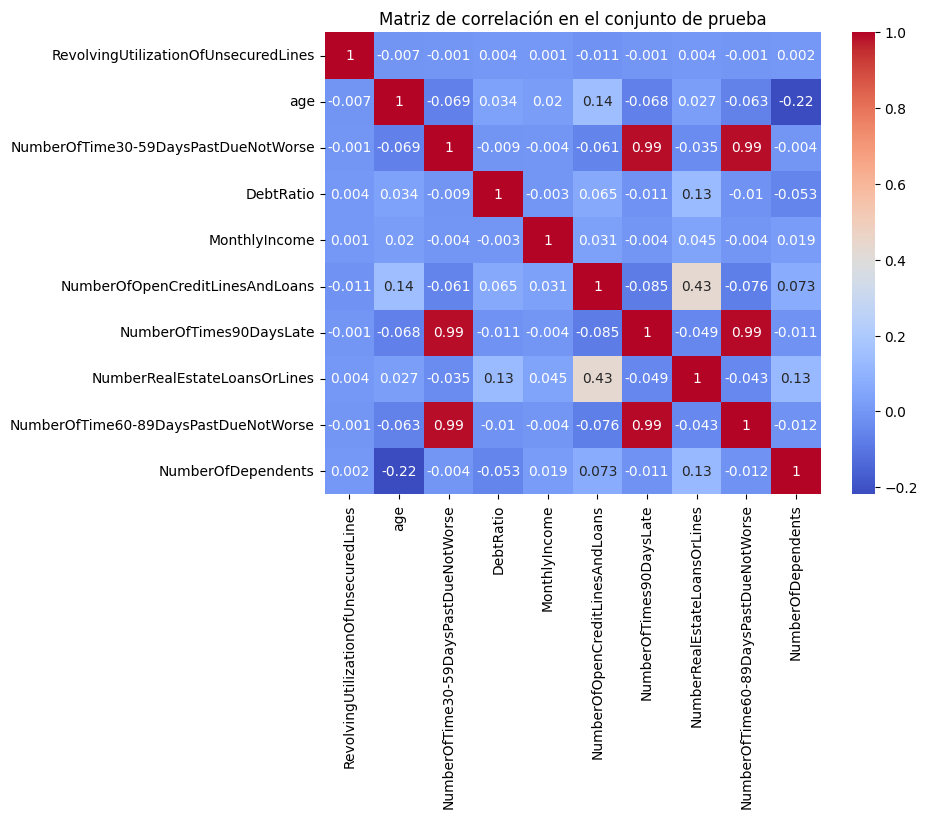

In [134]:
# Correlación entre variables numéricas - Mapa de calor
plt.figure(figsize=(8, 6))
sns.heatmap(training.drop(columns=['ID']).corr().round(3), annot=True, cmap='coolwarm') # Eliminar ID y redondear 2 decimales
plt.title('Matriz de correlación en el conjunto de entrenamiento')
plt.show()

plt.figure(figsize=(8, 6))
sns.heatmap(test.drop(columns=['ID' , 'SeriousDlqin2yrs']).corr().round(3), annot=True, cmap='coolwarm')
plt.title('Matriz de correlación en el conjunto de prueba')
plt.show()

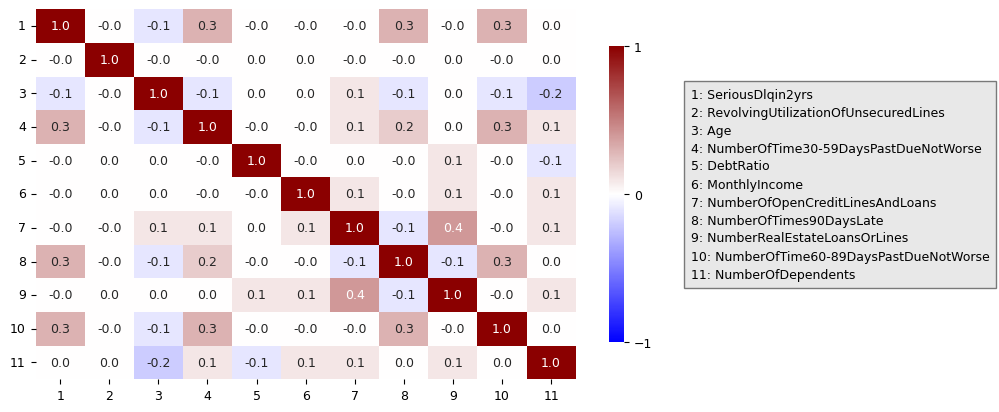

In [135]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import matplotlib.colors as mcolors

# Asumiendo que 'training' es el DataFrame utilizado
# Crear un diccionario de nombres de variables con sus respectivos números
variable_names = {
    1: 'SeriousDlqin2yrs',
    2: 'RevolvingUtilizationOfUnsecuredLines',
    3: 'Age',
    4: 'NumberOfTime30-59DaysPastDueNotWorse',
    5: 'DebtRatio',
    6: 'MonthlyIncome',
    7: 'NumberOfOpenCreditLinesAndLoans',
    8: 'NumberOfTimes90DaysLate',
    9: 'NumberRealEstateLoansOrLines',
    10: 'NumberOfTime60-89DaysPastDueNotWorse',
    11: 'NumberOfDependents'
}

# Crear una matriz de correlación y redondear los valores a una décima
corr_matrix = training.drop(columns=['ID']).corr().round(1)

# Renombrar las filas y columnas de la matriz de correlación con números
corr_matrix.columns = corr_matrix.index = range(1, len(corr_matrix.columns) + 1)

# Definir una paleta de colores personalizada de azul a blanco a rojo vinotinto
def custom_cmap():
    colors = ["#0000FF", "#FFFFFF", "#8B0000"]  # Azul, blanco, rojo vinotinto
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", colors)

# Crear la paleta de colores personalizada
cmap = custom_cmap()

# Crear la figura y el eje
plt.figure(figsize=(10, 5))  # Ajusta el ancho de la figura para dar espacio a la leyenda
ax = sns.heatmap(
    corr_matrix, 
    annot=True, 
    cmap=cmap, 
    fmt='.1f', 
    center=0, 
    cbar_kws={'shrink': 0.8, 'ticks': [-1, 0, 1]}, 
    vmin=-1, 
    vmax=1,
    annot_kws={"size": 9}  # Ajustar el tamaño de los números en las celdas
)

# Ajustar el tamaño de los números de filas y columnas
plt.xticks(rotation=0, fontsize=9)  # Tamaño de los números de las columnas
plt.yticks(rotation=0, fontsize=9)  # Tamaño de los números de las filas

# Ajustar el tamaño de los números en la escala de colores
colorbar = ax.collections[0].colorbar
colorbar.ax.tick_params(labelsize=9)  # Tamaño de los números en la barra de colores

# Ajustar el margen superior para dejar espacio para el título y subtítulo
plt.subplots_adjust(top=0.85, right=0.8)  # Ajusta el margen derecho aquí

# Añadir la leyenda a la derecha de la barra de escala
legend_text = "\n".join([f"{i}: {name}" for i, name in variable_names.items()])
plt.figtext(0.78, 0.5, legend_text, ha="left", fontsize=9, bbox={"facecolor":"lightgrey", "alpha":0.5, "pad":5}, va="center", linespacing=1.5)

plt.show()


In [136]:
# Eliminar la columna 'ID' del DataFrame
training_without_id = training.drop(columns=['ID'])

# Generar la matriz de correlación sin la columna 'ID'
correlation_matrix = training_without_id.corr()
correlation_matrix


,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
SeriousDlqin2yrs,1.000000,-0.001802,-0.115397,0.271411,-0.024558,-0.018002,-0.029669,0.311713,-0.007038,0.265594,0.046869
RevolvingUtilizationOfUnsecuredLines,-0.001802,1.000000,-0.005899,-0.002806,0.002997,0.006565,-0.011281,-0.001801,0.006235,-0.002434,0.001193
age,-0.115397,-0.005899,1.000000,-0.070918,0.043043,0.032984,0.147700,-0.081812,0.033172,-0.069278,-0.215676
NumberOfTime30-59DaysPastDueNotWorse,0.271411,-0.002806,-0.070918,1.000000,-0.011878,-0.001648,0.080904,0.218233,0.043296,0.305956,0.065807
DebtRatio,-0.024558,0.002997,0.043043,-0.011878,1.000000,-0.011186,0.012733,-0.011544,0.074009,-0.005188,-0.103492
MonthlyIncome,-0.018002,0.006565,0.032984,-0.001648,-0.011186,1.000000,0.082319,-0.017882,0.113823,-0.010469,0.058192
NumberOfOpenCreditLinesAndLoans,-0.029669,-0.011281,0.147700,0.080904,0.012733,0.082319,1.000000,-0.093090,0.433959,-0.021274,0.074026
NumberOfTimes90DaysLate,0.311713,-0.001801,-0.081812,0.218233,-0.011544,-0.017882,-0.093090,1.000000,-0.062123,0.294684,0.031439
NumberRealEstateLoansOrLines,-0.007038,0.006235,0.033172,0.043296,0.074009,0.113823,0.433959,-0.062123,1.000000,-0.020363,0.129399
NumberOfTime60-89DaysPastDueNotWorse,0.265594,-0.002434,-0.069278,0.305956,-0.005188,-0.010469,-0.021274,0.294684,-0.020363,1.000000,0.037739


In [137]:
# Función para identificar los outliers

def identificar_outliers(df, target_variable='SeriousDlqin2yrs', exclude_columns=['ID']):
    outliers_count_dict = {}
    for column in df.columns:
        if column not in exclude_columns and column != target_variable and pd.api.types.is_numeric_dtype(df[column]):
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            outliers_count = ((df[column] < lower_bound) | (df[column] > upper_bound)).sum()
            outliers_count_dict[column] = outliers_count
    return outliers_count_dict

# Identificar la cantidad de outliers en los DataFrames de training y test
outliers_count_training = identificar_outliers(training_modified)
outliers_count_test = identificar_outliers(test_modified)

# Crear un DataFrame que combine los resultados
outliers_summary_df = pd.DataFrame({
    'Variable': list(outliers_count_training.keys()),
    'Training': list(outliers_count_training.values()),
    'Training %': [outliers_count_training[var] / len(training) * 100 for var in outliers_count_training.keys()],
    'Test': list(outliers_count_test.values()),
    'Test %': [outliers_count_test[var] / len(test) * 100 for var in outliers_count_test.keys()]
}).round(2)

# Establecer la columna 'Variable' como índice
outliers_summary_df.set_index('Variable', inplace=True)

# Mostrar el DataFrame resultante
outliers_summary_df

# Exportar salida a excel
# outliers_summary_df.to_excel('outliers_summary_df.xlsx', index=True)




,Training,Training %,Test,Test %
Variable,,,,
RevolvingUtilizationOfUnsecuredLines,763,0.51,493,0.49
age,45,0.03,21,0.02
NumberOfTime30-59DaysPastDueNotWorse,23713,15.81,16313,16.07
DebtRatio,31311,20.87,21018,20.71
MonthlyIncome,9149,6.10,6087,6.00
NumberOfOpenCreditLinesAndLoans,3980,2.65,2699,2.66
NumberOfTimes90DaysLate,8069,5.38,5718,5.63
NumberRealEstateLoansOrLines,793,0.53,523,0.52
NumberOfTime60-89DaysPastDueNotWorse,7335,4.89,5128,5.05
